In [156]:
# imports

import pandas as pd
import seaborn as sn
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import plotly.express as px
import plotly.graph_objects as go

In [248]:
# we're gonna need the times of the day (0000, 0800, and 1600) and day numbers so that we can plot the results over time

df1 = pd.read_csv('day1_0000.csv')
df1['time'] = 0
df1['day'] = 1
df2 = pd.read_csv('day2_0000.csv')
df2['time'] = 0
df2['day'] = 2
df3 = pd.read_csv('day3_0000.csv')
df3['time'] = 0
df3['day'] = 3
df4 = pd.read_csv('day4_0000.csv')
df4['time'] = 0
df4['day'] = 4
df5 = pd.read_csv('day5_0000.csv')
df5['time'] = 0
df5['day'] = 5
df6 = pd.read_csv('day6_0000.csv')
df6['time'] = 0
df6['day'] = 6
df7 = pd.read_csv('day7_0000.csv')
df7['time'] = 0
df7['day'] = 7

df8 = pd.read_csv('day1_0800.csv')
df8['time'] = 8
df8['day'] = 1
df9 = pd.read_csv('day2_0800.csv')
df9['time'] = 8
df9['day'] = 2
df10 = pd.read_csv('day3_0800.csv')
df10['time'] = 8
df10['day'] = 3
df11 = pd.read_csv('day4_0800.csv')
df11['time'] = 8
df11['day'] = 4
df12 = pd.read_csv('day5_0800.csv')
df12['time'] = 8
df12['day'] = 5
df13 = pd.read_csv('day6_0800.csv')
df13['time'] = 8
df13['day'] = 6
df14 = pd.read_csv('day7_0800.csv')
df14['time'] = 8
df14['day'] = 7

df15 = pd.read_csv('day1_1600.csv')
df15['time'] = 16
df15['day'] = 1
df16 = pd.read_csv('day2_1600.csv')
df16['time'] = 16
df16['day'] = 2
df17 = pd.read_csv('day3_1600.csv')
df17['time'] = 16
df17['day'] = 3
df18 = pd.read_csv('day4_1600.csv')
df18['time'] = 16
df18['day'] = 4
df19 = pd.read_csv('day5_1600.csv')
df19['time'] = 16
df19['day'] = 5
df20 = pd.read_csv('day6_1600.csv')
df20['time'] = 16
df20['day'] = 6
df21 = pd.read_csv('day7_1600.csv')
df21['time'] = 16
df21['day'] = 7

### Merged data files

In [249]:
# all of the csv files contain the same columns, so we can concat them
# we can drop the indexes, as they don't bring valuable information

df = pd.concat([df1, df2, df3, df4, df5, df6, df7, df8, df9, df10, df11, df12, df13, df14, df15, df16, df17, df18, df19, df20, df21], ignore_index=True)
df = df.drop(['Unnamed: 0', 'index'], axis=1)
df

,Baseline: People Moving,Crisis: People Moving,x0,y0,x1,y1,time,day
0,14.000000,30,62.788086,8.425543,62.963867,8.425543,0,1
1,11.000000,24,62.788086,8.425543,63.227540,8.256863,0,1
2,16.666667,45,62.788086,8.425543,63.315430,8.172468,0,1
3,14.000000,31,62.788086,8.425543,63.491210,8.425543,0,1
4,13.000000,38,62.788086,9.350634,63.139650,9.350634,0,1
...,...,...,...,...,...,...,...,...
14154,12.000000,45,65.864260,11.932035,65.776370,11.932035,16,7
14155,14.000000,39,65.864260,11.932035,65.864260,12.014641,16,7
14156,12.000000,38,65.864260,12.673901,65.776370,12.673901,16,7
14157,23.333333,56,65.864260,12.673901,65.864260,12.591646,16,7


In [250]:
# we have overall 14159 instances, being either an int or a float
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14159 entries, 0 to 14158
Data columns (total 8 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Baseline: People Moving  14159 non-null  float64
 1   Crisis: People Moving    14159 non-null  int64  
 2   x0                       14159 non-null  float64
 3   y0                       14159 non-null  float64
 4   x1                       14159 non-null  float64
 5   y1                       14159 non-null  float64
 6   time                     14159 non-null  int64  
 7   day                      14159 non-null  int64  
dtypes: float64(5), int64(3)
memory usage: 885.1 KB


In [251]:
df.columns

Index(['Baseline: People Moving', 'Crisis: People Moving', 'x0', 'y0', 'x1',
       'y1', 'time', 'day'],
      dtype='object')

In [252]:
# there are no missing values
df.isnull().any()

Baseline: People Moving    False
Crisis: People Moving      False
x0                         False
y0                         False
x1                         False
y1                         False
time                       False
day                        False
dtype: bool

In [253]:
# the mean for the Baseline overall for all of the days is 28.92
# the mean for the Crisis overall for all of the days is 76.78

df[['Baseline: People Moving', 'Crisis: People Moving']].describe()

,Baseline: People Moving,Crisis: People Moving
count,14159.000000,14159.000000
mean,28.916440,76.775478
std,45.060578,123.669774
min,10.000000,10.000000
25%,12.615385,33.000000
50%,16.666667,47.000000
75%,28.000000,75.000000
max,840.428571,2384.000000


In [254]:
# measure the difference between the number of people moving now (during crisis) and baseline (before the crisis)
# positive change means the movement has increased compared to baseline
# negative change means the movement has decreased compared to baseline

df['people_moving_difference'] = df['Crisis: People Moving'] - df['Baseline: People Moving']
df

,Baseline: People Moving,Crisis: People Moving,x0,y0,x1,y1,time,day,people_moving_difference
0,14.000000,30,62.788086,8.425543,62.963867,8.425543,0,1,16.000000
1,11.000000,24,62.788086,8.425543,63.227540,8.256863,0,1,13.000000
2,16.666667,45,62.788086,8.425543,63.315430,8.172468,0,1,28.333333
3,14.000000,31,62.788086,8.425543,63.491210,8.425543,0,1,17.000000
4,13.000000,38,62.788086,9.350634,63.139650,9.350634,0,1,25.000000
...,...,...,...,...,...,...,...,...,...
14154,12.000000,45,65.864260,11.932035,65.776370,11.932035,16,7,33.000000
14155,14.000000,39,65.864260,11.932035,65.864260,12.014641,16,7,25.000000
14156,12.000000,38,65.864260,12.673901,65.776370,12.673901,16,7,26.000000
14157,23.333333,56,65.864260,12.673901,65.864260,12.591646,16,7,32.666667


In [255]:
df['people_moving_difference_percentage'] = (df['people_moving_difference'] / df['Baseline: People Moving']) * 100
df

,Baseline: People Moving,Crisis: People Moving,x0,y0,x1,y1,time,day,people_moving_difference,people_moving_difference_percentage
0,14.000000,30,62.788086,8.425543,62.963867,8.425543,0,1,16.000000,114.285714
1,11.000000,24,62.788086,8.425543,63.227540,8.256863,0,1,13.000000,118.181818
2,16.666667,45,62.788086,8.425543,63.315430,8.172468,0,1,28.333333,170.000000
3,14.000000,31,62.788086,8.425543,63.491210,8.425543,0,1,17.000000,121.428571
4,13.000000,38,62.788086,9.350634,63.139650,9.350634,0,1,25.000000,192.307692
...,...,...,...,...,...,...,...,...,...,...
14154,12.000000,45,65.864260,11.932035,65.776370,11.932035,16,7,33.000000,275.000000
14155,14.000000,39,65.864260,11.932035,65.864260,12.014641,16,7,25.000000,178.571429
14156,12.000000,38,65.864260,12.673901,65.776370,12.673901,16,7,26.000000,216.666667
14157,23.333333,56,65.864260,12.673901,65.864260,12.591646,16,7,32.666667,140.000000


In [256]:
# write the route {x0, y0; x1, y1} as a separate columns, so that we can sort the data based on the route
# I have sorted the df based on the route first, then based on the day and the time (e.g. {route} -> day1 -> 0000)

df['route'] = df.apply(lambda row: f"({row['x0']},{row['y0']}) -> ({row['x1']},{row['y1']})", axis=1)
df['day_hour_sorted'] = pd.to_datetime(df.apply(lambda row: f"{row['day']}-{row['time']:02d}", axis=1), format='%d-%H')
df = df.sort_values(by=['route', 'day', 'time'])
df

,Baseline: People Moving,Crisis: People Moving,x0,y0,x1,y1,time,day,people_moving_difference,people_moving_difference_percentage,route,day_hour_sorted
11309,10.333333,14,62.612305,10.020523,63.666992,10.437920,8,7,3.666667,35.483871,"(62.612305,10.020523) -> (63.666992,10.43792)",1900-01-07 08:00:00
9450,10.333333,17,62.612305,10.020523,64.809570,9.434505,8,5,6.666667,64.516129,"(62.612305,10.020523) -> (64.80957,9.434505)",1900-01-05 08:00:00
9451,10.333333,19,62.788086,8.425543,62.963867,8.256863,8,5,8.666667,83.870968,"(62.788086,8.425543) -> (62.963867,8.256863)",1900-01-05 08:00:00
0,14.000000,30,62.788086,8.425543,62.963867,8.425543,0,1,16.000000,114.285714,"(62.788086,8.425543) -> (62.963867,8.425543)",1900-01-01 00:00:00
5477,32.666667,87,62.788086,8.425543,62.963867,8.425543,8,1,54.333333,166.326531,"(62.788086,8.425543) -> (62.963867,8.425543)",1900-01-01 08:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...
4927,15.666667,65,65.864260,12.756109,65.864260,12.673901,0,6,49.333333,314.893617,"(65.86426,12.756109) -> (65.86426,12.673901)",1900-01-06 00:00:00
11308,20.333333,53,65.864260,12.756109,65.864260,12.673901,8,6,32.666667,160.655738,"(65.86426,12.756109) -> (65.86426,12.673901)",1900-01-06 08:00:00
5476,16.666667,57,65.864260,12.756109,65.864260,12.673901,0,7,40.333333,242.000000,"(65.86426,12.756109) -> (65.86426,12.673901)",1900-01-07 00:00:00
12037,20.333333,43,65.864260,12.756109,65.864260,12.673901,8,7,22.666667,111.475410,"(65.86426,12.756109) -> (65.86426,12.673901)",1900-01-07 08:00:00


In [183]:
# how overall the movement changed for every route over time (baseline and crisis)

fig = go.Figure()

for route in df['route'].unique():
    df_route = df[df['route'] == route]
    
    fig.add_trace(go.Scatter(x=df_route['day_hour_sorted'], y=df_route['Baseline: People Moving'], mode='lines+markers', name=f'Baseline {route}'))
    
    fig.add_trace(go.Scatter(x=df_route['day_hour_sorted'], y=df_route['Crisis: People Moving'], mode='lines+markers', name=f'Crisis {route}'))

fig.update_layout(
    title='Baseline and Crisis Movement Over Time for Each Route',
    xaxis_title='Day-Hour',
    yaxis_title='Number of People Moving',
    showlegend=True,
    xaxis=dict(tickformat='%d-%H')
)

fig.show()

Here we can see the fluctuations in the people moving. There can be seen a pattern in the movement, for example for most of the routes, there is a peak time period like 8:00 - 16:00. Also, it can be seen that by the end of the period (the 7th day), the numbers start to decrease gradually for mostly all of the routes.

There are heavy routes that are used by more than 2000 people per period (00-08). Route (65.77637,11.766699) -> (65.77637,11.849388) is the most popular among all. And the routes (64.28223,9.602135) -> (64.194336,9.68589), (64.63379,9.518339) -> (64.5459,9.602135), and (63.930664,8.678289) -> (64.018555,8.762463) are the least popular with only 10 people moving both before and after the crisis.

Only 276 routes have reduced the traffic, which might indicate effective social distancing measures, while 17 of them remained the same. The rest of the routes have actually increased traffic of movement. The increased movings can be explained by people going back their homes.

In [187]:
# how overall the movement changed for each route over time (difference in peopel moving)

fig = go.Figure()

for route in df['route'].unique():
    df_route = df[df['route'] == route]
    
    fig.add_trace(go.Scatter(x=df_route['day_hour_sorted'], y=df_route['people_moving_difference'], mode='lines+markers', name=f'{route}'))

fig.update_layout(
    title='Difference in Movement Over Time for Each Route',
    xaxis_title='Day-Hour',
    yaxis_title='Difference in Number of People Moving',
    showlegend=True,
    xaxis=dict(tickformat='%d-%H')
)

fig.show()

In [257]:
# average baseline, crisis, and average difference of movement for each area

df_avg = df.groupby('route').agg({
    'Baseline: People Moving': 'mean',
    'Crisis: People Moving': 'mean',
    'people_moving_difference': 'mean'
}).reset_index()
df_avg

,route,Baseline: People Moving,Crisis: People Moving,people_moving_difference
0,"(62.612305,10.020523) -> (63.666992,10.43792)",10.333333,14.000000,3.666667
1,"(62.612305,10.020523) -> (64.80957,9.434505)",10.333333,17.000000,6.666667
2,"(62.788086,8.425543) -> (62.963867,8.256863)",10.333333,19.000000,8.666667
3,"(62.788086,8.425543) -> (62.963867,8.425543)",20.063230,51.142857,31.079627
4,"(62.788086,8.425543) -> (62.963867,8.509829)",15.521876,35.111111,19.589235
...,...,...,...,...
1503,"(65.86426,12.591646) -> (65.86426,12.673901)",46.436562,158.380952,111.944390
1504,"(65.86426,12.673901) -> (65.77637,12.591646)",13.913233,47.500000,33.586767
1505,"(65.86426,12.673901) -> (65.77637,12.673901)",18.716815,66.761905,48.045090
1506,"(65.86426,12.673901) -> (65.86426,12.591646)",47.669786,162.666667,114.996881


### The data based on the days

In [258]:
baseline_sum = []
crisis_sum = []
baseline_mean = []
crisis_mean = []

In [259]:
df_day1 = pd.concat([df1, df8, df15], ignore_index=True)
df_day1 = df_day1.drop(['Unnamed: 0', 'index'], axis=1)
df_day1

,Baseline: People Moving,Crisis: People Moving,x0,y0,x1,y1,time,day
0,14.000000,30,62.788086,8.425543,62.963867,8.425543,0,1
1,11.000000,24,62.788086,8.425543,63.227540,8.256863,0,1
2,16.666667,45,62.788086,8.425543,63.315430,8.172468,0,1
3,14.000000,31,62.788086,8.425543,63.491210,8.425543,0,1
4,13.000000,38,62.788086,9.350634,63.139650,9.350634,0,1
...,...,...,...,...,...,...,...,...
2189,14.000000,33,65.864260,11.932035,65.776370,11.849388,16,1
2190,10.333333,35,65.864260,11.932035,65.776370,11.932035,16,1
2191,11.000000,52,65.864260,11.932035,65.864260,12.014641,16,1
2192,14.000000,45,65.864260,12.673901,65.776370,12.673901,16,1


In [260]:
baseline_sum.append(df_day1['Baseline: People Moving'].sum())
crisis_sum.append(df_day1['Crisis: People Moving'].sum())
baseline_mean.append(df_day1['Baseline: People Moving'].mean())
crisis_mean.append(df_day1['Crisis: People Moving'].mean())

df_day1[['Baseline: People Moving', 'Crisis: People Moving']].describe()

,Baseline: People Moving,Crisis: People Moving
count,2194.000000,2194.000000
mean,29.296253,82.489973
std,46.398574,134.707801
min,10.000000,10.000000
25%,13.000000,35.000000
50%,16.666667,49.000000
75%,28.000000,81.000000
max,799.666667,2384.000000


In [261]:
df_day2 = pd.concat([df2, df9, df16], ignore_index=True)
df_day2 = df_day2.drop(['Unnamed: 0', 'index'], axis=1)
df_day2

,Baseline: People Moving,Crisis: People Moving,x0,y0,x1,y1,time,day
0,12.000000,37,62.788086,8.425543,62.963867,8.425543,0,2
1,10.333333,30,62.788086,8.425543,62.963867,8.509829,0,2
2,13.000000,27,62.788086,8.425543,63.315430,8.172468,0,2
3,12.000000,35,62.788086,9.350634,63.139650,9.350634,0,2
4,11.000000,35,62.788086,9.434505,62.963867,9.098787,0,2
...,...,...,...,...,...,...,...,...
2101,11.000000,28,65.864260,11.932035,65.776370,11.849388,16,2
2102,10.333333,33,65.864260,11.932035,65.776370,11.932035,16,2
2103,12.000000,42,65.864260,11.932035,65.864260,12.014641,16,2
2104,12.000000,44,65.864260,12.673901,65.776370,12.673901,16,2


In [262]:
baseline_sum.append(df_day2['Baseline: People Moving'].sum())
crisis_sum.append(df_day2['Crisis: People Moving'].sum())
baseline_mean.append(df_day2['Baseline: People Moving'].mean())
crisis_mean.append(df_day2['Crisis: People Moving'].mean())

df_day2[['Baseline: People Moving', 'Crisis: People Moving']].describe()

,Baseline: People Moving,Crisis: People Moving
count,2106.000000,2106.000000
mean,29.586733,81.577873
std,47.142480,134.983852
min,10.000000,10.000000
25%,13.000000,35.000000
50%,16.666667,48.000000
75%,28.666667,79.000000
max,790.466667,2345.000000


In [263]:
df_day3 = pd.concat([df3, df10, df17], ignore_index=True)
df_day3 = df_day3.drop(['Unnamed: 0', 'index'], axis=1)
df_day3

,Baseline: People Moving,Crisis: People Moving,x0,y0,x1,y1,time,day
0,11.615385,39,62.788086,8.425543,62.963867,8.425543,0,3
1,12.615385,33,62.788086,8.425543,63.315430,8.172468,0,3
2,10.000000,40,62.788086,9.350634,63.139650,9.350634,0,3
3,42.307692,15,62.788086,9.434505,62.963867,9.434505,0,3
4,12.615385,44,62.788086,9.434505,63.051758,9.098787,0,3
...,...,...,...,...,...,...,...,...
1939,10.000000,44,65.864260,11.849388,65.776370,11.766699,16,3
1940,16.230769,58,65.864260,11.849388,65.864260,11.766699,16,3
1941,10.000000,40,65.864260,11.932035,65.776370,11.849388,16,3
1942,10.000000,56,65.864260,12.673901,65.776370,12.673901,16,3


In [264]:
baseline_sum.append(df_day3['Baseline: People Moving'].sum())
crisis_sum.append(df_day3['Crisis: People Moving'].sum())
baseline_mean.append(df_day3['Baseline: People Moving'].mean())
crisis_mean.append(df_day3['Crisis: People Moving'].mean())

df_day3[['Baseline: People Moving', 'Crisis: People Moving']].describe()

,Baseline: People Moving,Crisis: People Moving
count,1944.000000,1944.000000
mean,28.229873,85.006687
std,44.185518,139.491406
min,10.000000,10.000000
25%,11.615385,36.000000
50%,16.230769,52.000000
75%,26.461538,84.000000
max,696.923077,2342.000000


In [265]:
df_day4 = pd.concat([df4, df11, df18], ignore_index=True)
df_day4 = df_day4.drop(['Unnamed: 0', 'index'], axis=1)
df_day4

,Baseline: People Moving,Crisis: People Moving,x0,y0,x1,y1,time,day
0,14.357143,37,62.788086,8.425543,62.963867,8.425543,0,4
1,10.357143,20,62.788086,8.425543,62.963867,8.509829,0,4
2,11.357143,18,62.788086,8.425543,63.051758,8.678289,0,4
3,16.071429,16,62.788086,8.425543,63.315430,8.172468,0,4
4,10.642857,19,62.788086,8.425543,63.491210,8.425543,0,4
...,...,...,...,...,...,...,...,...
2321,14.357143,28,65.864260,11.932035,65.776370,11.849388,16,4
2322,11.357143,46,65.864260,11.932035,65.776370,11.932035,16,4
2323,11.357143,37,65.864260,11.932035,65.864260,12.014641,16,4
2324,14.357143,51,65.864260,12.673901,65.776370,12.673901,16,4


In [266]:
baseline_sum.append(df_day4['Baseline: People Moving'].sum())
crisis_sum.append(df_day4['Crisis: People Moving'].sum())
baseline_mean.append(df_day4['Baseline: People Moving'].mean())
crisis_mean.append(df_day4['Crisis: People Moving'].mean())

df_day4[['Baseline: People Moving', 'Crisis: People Moving']].describe()

,Baseline: People Moving,Crisis: People Moving
count,2326.000000,2326.000000
mean,30.540364,74.214101
std,47.952272,121.573701
min,10.000000,10.000000
25%,13.357143,30.000000
50%,18.071429,45.000000
75%,29.214286,72.000000
max,840.428571,2049.000000


In [267]:
df_day5 = pd.concat([df5, df12, df19], ignore_index=True)
df_day5 = df_day5.drop(['Unnamed: 0', 'index'], axis=1)
df_day5

,Baseline: People Moving,Crisis: People Moving,x0,y0,x1,y1,time,day
0,12.000000,83,62.788086,8.425543,62.963867,8.425543,0,5
1,11.000000,22,62.788086,8.425543,62.963867,8.509829,0,5
2,14.000000,21,62.788086,8.425543,63.315430,8.172468,0,5
3,10.333333,15,62.788086,8.425543,63.491210,8.425543,0,5
4,12.000000,31,62.788086,9.350634,63.139650,9.350634,0,5
...,...,...,...,...,...,...,...,...
2218,13.000000,37,65.864260,11.932035,65.776370,11.849388,16,5
2219,11.000000,40,65.864260,11.932035,65.776370,11.932035,16,5
2220,10.333333,45,65.864260,11.932035,65.864260,12.014641,16,5
2221,11.000000,47,65.864260,12.673901,65.776370,12.673901,16,5


In [268]:
baseline_sum.append(df_day5['Baseline: People Moving'].sum())
crisis_sum.append(df_day5['Crisis: People Moving'].sum())
baseline_mean.append(df_day5['Baseline: People Moving'].mean())
crisis_mean.append(df_day5['Crisis: People Moving'].mean())

df_day5[['Baseline: People Moving', 'Crisis: People Moving']].describe()

,Baseline: People Moving,Crisis: People Moving
count,2223.000000,2223.000000
mean,29.224993,76.120108
std,46.246692,126.704080
min,10.000000,10.000000
25%,12.633333,32.000000
50%,16.666667,45.000000
75%,28.000000,74.000000
max,795.066667,2262.000000


In [269]:
df_day6 = pd.concat([df6, df13, df20], ignore_index=True)
df_day6 = df_day6.drop(['Unnamed: 0', 'index'], axis=1)
df_day6

,Baseline: People Moving,Crisis: People Moving,x0,y0,x1,y1,time,day
0,15.666667,46,62.788086,8.425543,62.963867,8.425543,0,6
1,10.333333,10,62.788086,8.425543,62.963867,8.509829,0,6
2,14.666667,19,62.788086,8.425543,63.315430,8.172468,0,6
3,10.333333,15,62.788086,8.425543,63.491210,8.425543,0,6
4,12.000000,22,62.788086,9.434505,62.963867,9.098787,0,6
...,...,...,...,...,...,...,...,...
1790,10.333333,34,65.864260,11.849388,65.864260,11.932035,16,6
1791,11.000000,32,65.864260,11.932035,65.776370,11.932035,16,6
1792,10.333333,33,65.864260,11.932035,65.864260,12.014641,16,6
1793,14.666667,39,65.864260,12.673901,65.776370,12.673901,16,6


In [270]:
baseline_sum.append(df_day6['Baseline: People Moving'].sum())
crisis_sum.append(df_day6['Crisis: People Moving'].sum())
baseline_mean.append(df_day6['Baseline: People Moving'].mean())
crisis_mean.append(df_day6['Crisis: People Moving'].mean())

df_day6[['Baseline: People Moving', 'Crisis: People Moving']].describe()

,Baseline: People Moving,Crisis: People Moving
count,1795.000000,1795.000000
mean,28.958301,73.411142
std,44.416187,108.558300
min,10.000000,10.000000
25%,13.000000,32.000000
50%,16.666667,45.000000
75%,28.000000,72.000000
max,673.533333,1559.000000


In [271]:
df_day7 = pd.concat([df7, df17, df21], ignore_index=True)
df_day7 = df_day7.drop(['Unnamed: 0', 'index'], axis=1)
df_day7

,Baseline: People Moving,Crisis: People Moving,x0,y0,x1,y1,time,day
0,14.666667,35,62.788086,8.425543,62.963867,8.425543,0,7
1,12.000000,19,62.788086,8.425543,63.315430,8.172468,0,7
2,10.333333,20,62.788086,9.434505,62.963867,9.350634,0,7
3,13.000000,18,62.788086,9.434505,63.139650,9.350634,0,7
4,11.000000,11,62.788086,9.434505,63.227540,9.685890,0,7
...,...,...,...,...,...,...,...,...
1107,12.000000,45,65.864260,11.932035,65.776370,11.932035,16,7
1108,14.000000,39,65.864260,11.932035,65.864260,12.014641,16,7
1109,12.000000,38,65.864260,12.673901,65.776370,12.673901,16,7
1110,23.333333,56,65.864260,12.673901,65.864260,12.591646,16,7


In [272]:
baseline_sum.append(df_day7['Baseline: People Moving'].sum())
crisis_sum.append(df_day7['Crisis: People Moving'].sum())
baseline_mean.append(df_day7['Baseline: People Moving'].mean())
crisis_mean.append(df_day7['Crisis: People Moving'].mean())

df_day7[['Baseline: People Moving', 'Crisis: People Moving']].describe()

,Baseline: People Moving,Crisis: People Moving
count,1112.000000,1112.000000
mean,24.619383,63.429856
std,32.938789,75.845659
min,10.000000,10.000000
25%,12.000000,33.000000
50%,15.666667,44.500000
75%,23.333333,64.000000
max,432.333333,970.000000


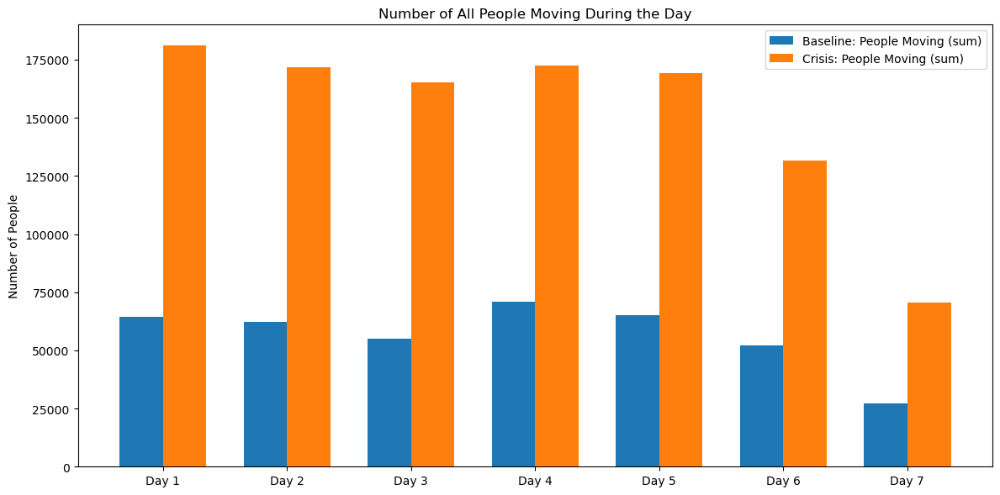

In [273]:
labels = ['Day 1', 'Day 2', 'Day 3', 'Day 4', 'Day 5', 'Day 6', 'Day 7']

x = np.arange(len(labels))
width = 0.35

fig, ax = plt.subplots(figsize=(12, 6))
rects1 = ax.bar(x - width/2, baseline_sum, width, label='Baseline: People Moving (sum)')
rects2 = ax.bar(x + width/2, crisis_sum, width, label='Crisis: People Moving (sum)')

ax.set_ylabel('Number of People')
ax.set_title('Number of All People Moving During the Day')
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend()

fig.tight_layout()

plt.show()

We can see that overall trend is that during crisis People Moving has increased drastically, gradually slowing down closer to the last days.

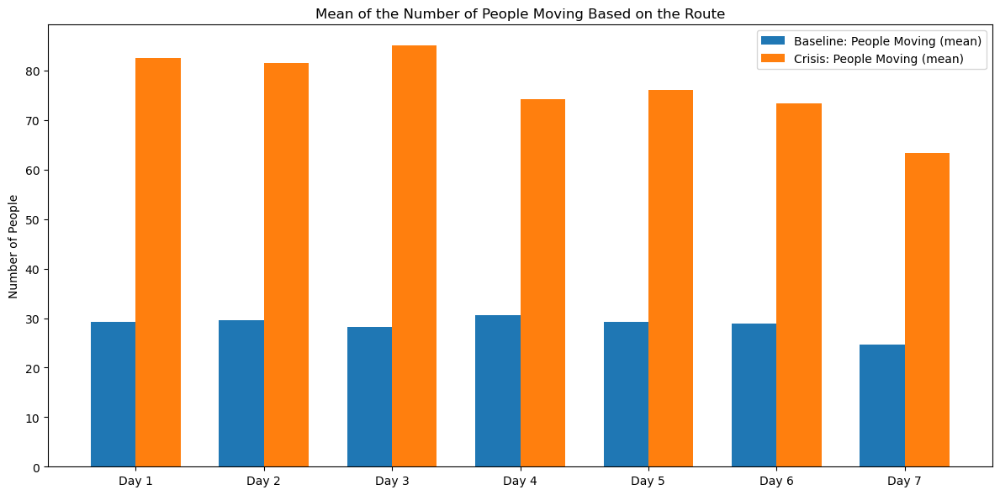

In [274]:
labels = ['Day 1', 'Day 2', 'Day 3', 'Day 4', 'Day 5', 'Day 6', 'Day 7']

x = np.arange(len(labels))
width = 0.35

fig, ax = plt.subplots(figsize=(12, 6))
rects1 = ax.bar(x - width/2, baseline_mean, width, label='Baseline: People Moving (mean)')
rects2 = ax.bar(x + width/2, crisis_mean, width, label='Crisis: People Moving (mean)')

ax.set_ylabel('Number of People')
ax.set_title('Mean of the Number of People Moving Based on the Route')
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend()

fig.tight_layout()

plt.show()

The mean for the baseline before the crisis was more or less similar all of the days. After the crisis, the average number of people moving has increased remarkably and decreased a bit in the end.

### Merged by time

In [278]:
df_0000 = pd.concat([df1, df2, df3, df4, df5, df6, df7], ignore_index=True)
df_0000 = df_0000.drop(['Unnamed: 0', 'index'], axis=1)
df_0000['people_moving_difference'] = df_0000['Crisis: People Moving'] - df_0000['Baseline: People Moving']
df_0000

,Baseline: People Moving,Crisis: People Moving,x0,y0,x1,y1,time,day,people_moving_difference
0,14.000000,30,62.788086,8.425543,62.963867,8.425543,0,1,16.000000
1,11.000000,24,62.788086,8.425543,63.227540,8.256863,0,1,13.000000
2,16.666667,45,62.788086,8.425543,63.315430,8.172468,0,1,28.333333
3,14.000000,31,62.788086,8.425543,63.491210,8.425543,0,1,17.000000
4,13.000000,38,62.788086,9.350634,63.139650,9.350634,0,1,25.000000
...,...,...,...,...,...,...,...,...,...
5472,15.666667,63,65.864260,12.427008,65.864260,12.509350,0,7,47.333333
5473,14.000000,23,65.864260,12.673901,65.776370,12.591646,0,7,9.000000
5474,18.666667,53,65.864260,12.673901,65.776370,12.673901,0,7,34.333333
5475,44.000000,149,65.864260,12.673901,65.864260,12.591646,0,7,105.000000


In [279]:
df_0800 = pd.concat([df8, df9, df10, df11, df12, df13, df14], ignore_index=True)
df_0800 = df_0800.drop(['Unnamed: 0', 'index'], axis=1)
df_0800['people_moving_difference'] = df_0800['Crisis: People Moving'] - df_0800['Baseline: People Moving']
df_0800

,Baseline: People Moving,Crisis: People Moving,x0,y0,x1,y1,time,day,people_moving_difference
0,32.666667,87,62.788086,8.425543,62.963867,8.425543,8,1,54.333333
1,22.333333,70,62.788086,8.425543,62.963867,8.509829,8,1,47.666667
2,12.000000,47,62.788086,8.425543,62.963867,8.594076,8,1,35.000000
3,12.000000,30,62.788086,8.425543,63.051758,8.678289,8,1,18.000000
4,19.333333,40,62.788086,8.425543,63.227540,8.256863,8,1,20.666667
...,...,...,...,...,...,...,...,...,...
6556,18.666667,59,65.864260,12.427008,65.864260,12.509350,8,7,40.333333
6557,10.333333,23,65.864260,12.673901,65.776370,12.591646,8,7,12.666667
6558,28.000000,78,65.864260,12.673901,65.776370,12.673901,8,7,50.000000
6559,52.885675,126,65.864260,12.673901,65.864260,12.591646,8,7,73.114325


In [280]:
df_1600 = pd.concat([df15, df16, df17, df18, df19, df20, df21], ignore_index=True)
df_1600 = df_1600.drop(['Unnamed: 0', 'index'], axis=1)
df_1600['people_moving_difference'] = df_1600['Crisis: People Moving'] - df_1600['Baseline: People Moving']
df_1600

,Baseline: People Moving,Crisis: People Moving,x0,y0,x1,y1,time,day,people_moving_difference
0,14.666667,35,62.788086,8.425543,62.963867,8.425543,16,1,20.333333
1,12.000000,22,62.788086,8.425543,62.963867,8.509829,16,1,10.000000
2,14.666667,29,62.788086,9.434505,62.963867,9.350634,16,1,14.333333
3,29.666667,79,62.875977,8.425543,62.963867,8.425543,16,1,49.333333
4,20.333333,35,62.875977,8.425543,62.963867,8.509829,16,1,14.666667
...,...,...,...,...,...,...,...,...,...
2116,12.000000,45,65.864260,11.932035,65.776370,11.932035,16,7,33.000000
2117,14.000000,39,65.864260,11.932035,65.864260,12.014641,16,7,25.000000
2118,12.000000,38,65.864260,12.673901,65.776370,12.673901,16,7,26.000000
2119,23.333333,56,65.864260,12.673901,65.864260,12.591646,16,7,32.666667


In [312]:
df_1600.groupby('day').agg({
    'people_moving_difference': 'sum'
}).reset_index().sort_values(by=['people_moving_difference'])

,day,people_moving_difference
6,7,9143.000000
5,6,9818.417217
4,5,11705.266667
3,4,12504.428571
2,3,13235.178893
1,2,13653.600000
0,1,14338.066667


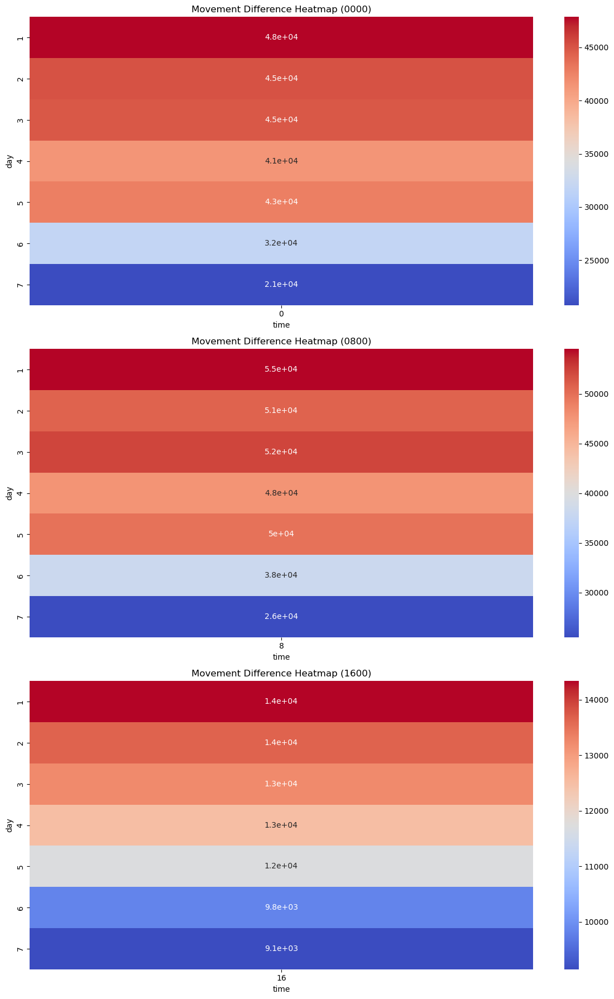

In [283]:
pivot_0000 = df_0000.pivot_table(index='day', columns='time', values='people_moving_difference', aggfunc='sum')
pivot_0800 = df_0800.pivot_table(index='day', columns='time', values='people_moving_difference', aggfunc='sum')
pivot_1600 = df_1600.pivot_table(index='day', columns='time', values='people_moving_difference', aggfunc='sum')

fig, ax = plt.subplots(3, 1, figsize=(12, 18))

sn.heatmap(pivot_0000, ax=ax[0], annot=True, cmap='coolwarm')
ax[0].set_title('Movement Difference Heatmap (0000)')

sn.heatmap(pivot_0800, ax=ax[1], annot=True, cmap='coolwarm')
ax[1].set_title('Movement Difference Heatmap (0800)')

sn.heatmap(pivot_1600, ax=ax[2], annot=True, cmap='coolwarm')
ax[2].set_title('Movement Difference Heatmap (1600)')

plt.tight_layout()
plt.show()

If we look at all the days during the period 00:00 - 08:00, the most of the movings were made in the day 1 (47854.816733 people) and the less is done in the day 7 (20779.066667 people). The order (descending) is as follows: 1,2,3,5,4,6,7.

For the period 08:00 - 16: 00, the order (descending) is like these: 1,3,2,5,4,6,7 (by days). On the first day 54514.137885 people moved, and on the 7th day, 25513.769730 people.

For the period 16:00 - 00:00, the order (descending) is as follows: 1,2,3,4,5,6,7 (by days). On the first day 14338.066667 people moved, and on the 7th day 9143 people moved.

As we can see from the heatmap, the peak movements were made during the 08:00 - 16:00 period of time, the least active period was between 16:00 and 00:00. On the both 6th and 7th days the traffic decreased.

In [321]:
df_baseline = df[df['Baseline: People Moving'] > 0]

fig = go.Figure()

fig.add_trace(go.Scattergeo(
    lon=df_baseline['x0'],
    lat=df_baseline['y0'],
    mode='markers',
    marker=dict(size=8, color='blue'),
    name='Origin'
))

fig.add_trace(go.Scattergeo(
    lon=df_baseline['x1'],
    lat=df_baseline['y1'],
    mode='markers',
    marker=dict(size=8, color='red'),
    name='Destination'
))

for i, row in df_baseline.iterrows():
    fig.add_trace(go.Scattergeo(
        lon=[row['x0'], row['x1']],
        lat=[row['y0'], row['y1']],
        mode='lines',
        line=dict(width=2, color='green'),
        name='Movement',
        showlegend=False,
        hoverinfo='text',
        text=f'Baseline: {row["Baseline: People Moving"]}'
    ))

fig.update_layout(
    title='Baseline Movement Routes',
    showlegend=True,
    geo=dict(
        scope='world',
        projection=go.layout.geo.Projection(type='natural earth'),
        showland=True,
    ),
    height=600,
    width=1200
)

fig.show()

In [322]:
df_crisis = df[df['Crisis: People Moving'] > 0]

fig = go.Figure()

fig.add_trace(go.Scattergeo(
    lon=df_crisis['x0'],
    lat=df_crisis['y0'],
    mode='markers',
    marker=dict(size=8, color='blue'),
    name='Origin'
))

fig.add_trace(go.Scattergeo(
    lon=df_crisis['x1'],
    lat=df_crisis['y1'],
    mode='markers',
    marker=dict(size=8, color='red'),
    name='Destination'
))

for i, row in df_crisis.iterrows():
    fig.add_trace(go.Scattergeo(
        lon=[row['x0'], row['x1']],
        lat=[row['y0'], row['y1']],
        mode='lines',
        line=dict(width=2, color='green'),
        name='Movement',
        showlegend=False,
        hoverinfo='text',
        text=f'Crisis: {row["Crisis: People Moving"]}'
    ))

fig.update_layout(
    title='Crisis Movement Routes',
    showlegend=True,
    geo=dict(
        scope='world',
        projection=go.layout.geo.Projection(type='natural earth'),
        showland=True,
    ),
    height=600,
    width=1200
)

fig.show()